### LSE Data Analytics Online Career Accelerator

# DA201: Data Analytics using Python

## Assignment: COVID-19 data

## 0) Environment preparation

In [203]:
# Import the required libraries and set the plotting options
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

sns.set(rc = {'figure.figsize':(15,10)})

## 1) Assignment activity 1: 

### 1.1) Report/notebook expectations:
- Illustrate your GitHub setup consisting of the load and push updates of all the Jupyter Notebook files. (**Hint**: Make sure that your GitHub username, the directory structure and updates are visible in the screenshot. Make sure to provide a zipped copy of the folder containing your submission Notebook as well as supporting files such as images used in the Notebook.)

### Required: Report submission:
Please  URL (to your public GitHub repository) and a screenshot - double click cell to edit
- [My Github Repo](https://github.com/JavierConde1976/LSE_DA_COVID_analysis)

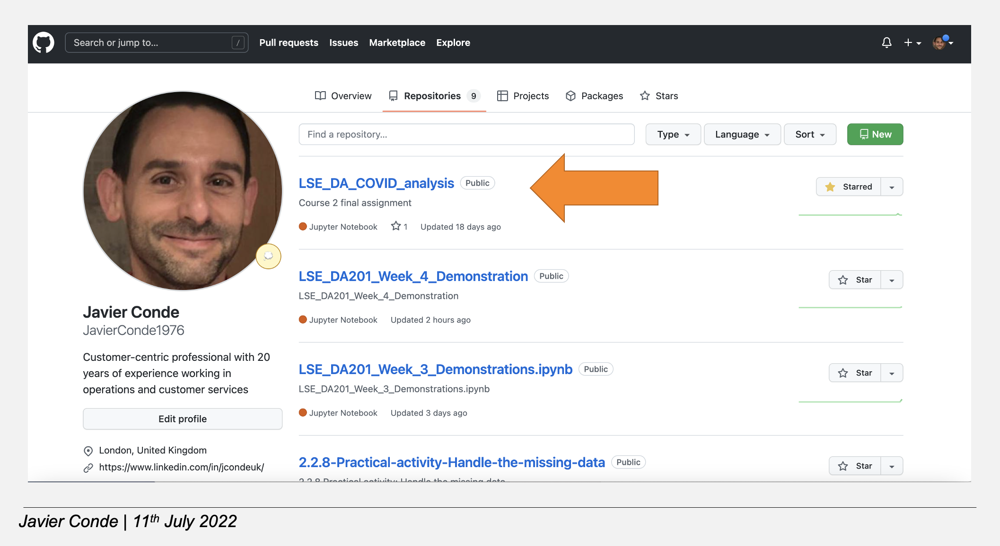

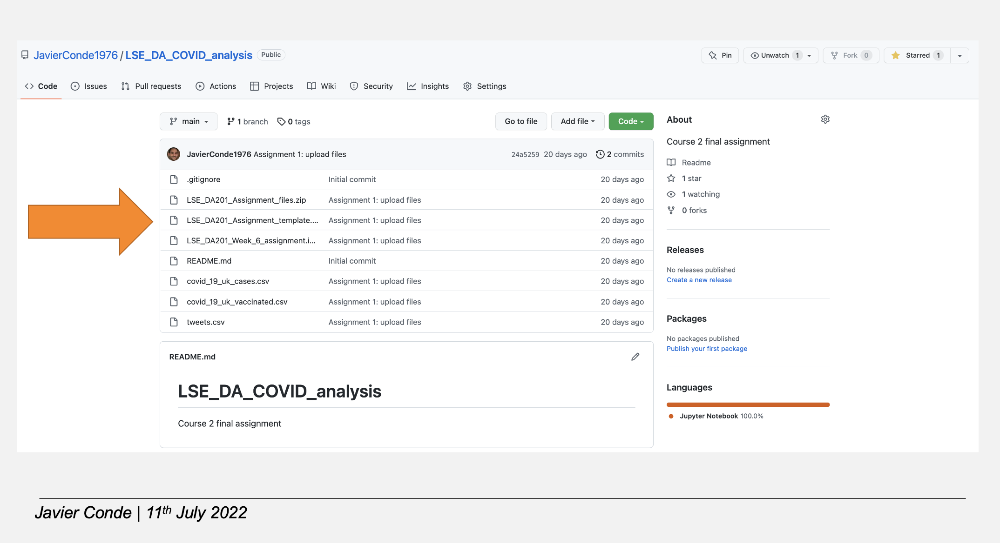

### 1.2) Presentation expectations:
- Describe the role and how workflow tools such as GitHub can be used to add value to organisations.

In the role of data analyst working with the UK government to analyse COVID-19 data, having reliable repositories to control accurately the different versions and add ons to the code is essential in the day to day work. Change control management. As a Distributed CVS, Github will help us to control the overall progression of the worl, the different steps we are accomplising along the way and any changes we make to the original Python code block.

### Optional for notebook/Required for presentation.
- You can use this cell as placeholder for bullet points to include in your presentation. 
- This section will not be graded in the Notebook, grades awarded based on presentation content only. 

(Double-click to edit)

## 2) Assignment activity 2: 

### 2.1) Report expectations:
- Load the files `covid_19_uk_cases.csv` and `covid_19_uk_vaccinated.csv` and explore the data.
- Explore the data using the `info()`, `describe()`, `shape` and `value_counts()` methods, and note the observations regarding data types, number or records and features.
- Identify missing data.
- Filter/subset data.
- Aggregate data (totals and by month).
- Note observations.

In [204]:
# Load the COVID-19 cases and vaccine data sets as cov and vac respectively.

### To start understanding the campaign strategy, let's identify:

- the number of people who have received a first dose
- the number of people who have received a second dose
- the number of people vaccinated in a particular region.

In [205]:
# Let's load the COVID-19 cases and vaccine data sets as cov and vac respectively.
cov = pd.read_csv('covid_19_uk_cases.csv')
vac = pd.read_csv('covid_19_uk_vaccinated.csv')

In [208]:
# We explore first the 'cov' DataFrame (with 'shape', 'dtypes','columns', 'head', 'tail' arguments).

print(cov.shape)
print(cov.dtypes)
print(cov.columns)
cov.head()

(7584, 12)
Province/State               object
Country/Region               object
Lat                         float64
Long                        float64
ISO 3166-1 Alpha 3-Codes     object
Sub-region Name              object
Intermediate Region Code      int64
Date                         object
Deaths                      float64
Cases                       float64
Recovered                   float64
Hospitalised                float64
dtype: object
Index(['Province/State', 'Country/Region', 'Lat', 'Long',
       'ISO 3166-1 Alpha 3-Codes', 'Sub-region Name',
       'Intermediate Region Code', 'Date', 'Deaths', 'Cases', 'Recovered',
       'Hospitalised'],
      dtype='object')


,Province/State,Country/Region,Lat,Long,ISO 3166-1 Alpha 3-Codes,Sub-region Name,Intermediate Region Code,Date,Deaths,Cases,Recovered,Hospitalised
0,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-22,0.0,0.0,0.0,0.0
1,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-23,0.0,0.0,0.0,0.0
2,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-24,0.0,0.0,0.0,0.0
3,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-25,0.0,0.0,0.0,0.0
4,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-26,0.0,0.0,0.0,0.0


In [209]:
cov.tail()

,Province/State,Country/Region,Lat,Long,ISO 3166-1 Alpha 3-Codes,Sub-region Name,Intermediate Region Code,Date,Deaths,Cases,Recovered,Hospitalised
7579,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-10,137735.0,8154306.0,0.0,378.0
7580,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-11,137763.0,8193769.0,0.0,386.0
7581,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-12,137944.0,8231437.0,0.0,386.0
7582,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-13,138080.0,8272883.0,0.0,0.0
7583,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-14,138237.0,8317439.0,0.0,0.0


In [250]:
# Being cumulative, we can group by province to get an overview

cov.groupby('Province/State')[['Deaths', 'Cases', 'Recovered', 'Hospitalised']].max()

,Deaths,Cases,Recovered,Hospitalised
Province/State,,,,
Anguilla,1.0,644.0,111.0,4122.0
Bermuda,95.0,5548.0,2503.0,2355.0
British Virgin Islands,37.0,2725.0,1914.0,4318.0
Cayman Islands,2.0,1011.0,635.0,2944.0
Channel Islands,100.0,12135.0,8322.0,2748.0
Falkland Islands (Malvinas),0.0,69.0,63.0,3140.0
Gibraltar,97.0,5727.0,4670.0,4907.0
Isle of Man,54.0,8343.0,4019.0,3533.0
Montserrat,1.0,41.0,19.0,4514.0


In [211]:
# Let's find empty values in 'cov' DataFrame.

print(cov.isnull().values.any())
print(cov.isnull().sum().sum())

True
8


In [212]:
# 'cov' DataFrame does have 8 empty values NaN.

In [213]:
# Now let's explore the 'vac' DataFrame with 'shape', 'dtypes','columns', 'head', 'tail' arguments

print(vac.shape)
print(vac.dtypes)
print(vac.columns)
print(vac.head())
print(vac.tail())

(7584, 11)
Province/State               object
Country/Region               object
Lat                         float64
Long                        float64
ISO 3166-1 Alpha 3-Codes     object
Sub-region Name              object
Intermediate Region Code      int64
Date                         object
Vaccinated                    int64
First Dose                    int64
Second Dose                   int64
dtype: object
Index(['Province/State', 'Country/Region', 'Lat', 'Long',
       'ISO 3166-1 Alpha 3-Codes', 'Sub-region Name',
       'Intermediate Region Code', 'Date', 'Vaccinated', 'First Dose',
       'Second Dose'],
      dtype='object')
  Province/State  Country/Region      Lat     Long ISO 3166-1 Alpha 3-Codes  \
0       Anguilla  United Kingdom  18.2206 -63.0686                      AIA   
1       Anguilla  United Kingdom  18.2206 -63.0686                      AIA   
2       Anguilla  United Kingdom  18.2206 -63.0686                      AIA   
3       Anguilla  United Kingdom  1

In [214]:
# Exploring empty values in cov DataFrame.

print(vac.isnull().values.any())
print(vac.isnull().sum().sum())

False
0


In [215]:
# vac DataFrame does not have any empty values NaN.

In [216]:
vac.tail()

,Province/State,Country/Region,Lat,Long,ISO 3166-1 Alpha 3-Codes,Sub-region Name,Intermediate Region Code,Date,Vaccinated,First Dose,Second Dose
7579,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-10,1070,1216,1070
7580,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-11,1300,1604,1300
7581,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-12,1482,2027,1482
7582,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-13,0,0,0
7583,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-14,0,0,0


In [217]:
# To create DataFrame based on Gibraltar data, first let's find if Gibraltar 
# is in the column Province/State.
cov['Province/State'].unique()

array(['Anguilla', 'Bermuda', 'British Virgin Islands', 'Cayman Islands',
       'Channel Islands', 'Falkland Islands (Malvinas)', 'Gibraltar',
       'Isle of Man', 'Montserrat',
       'Saint Helena, Ascension and Tristan da Cunha',
       'Turks and Caicos Islands', 'Others'], dtype=object)

In [218]:
# 'Gibraltar' appears in column 'Province/State'. Now let's filter the DataFrame by value 'Gibraltar'
cov_gibraltar = (cov[cov['Province/State']=='Gibraltar'])
cov_gibraltar

,Province/State,Country/Region,Lat,Long,ISO 3166-1 Alpha 3-Codes,Sub-region Name,Intermediate Region Code,Date,Deaths,Cases,Recovered,Hospitalised
3792,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-22,0.0,0.0,0.0,0.0
3793,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-23,0.0,0.0,0.0,0.0
3794,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-24,0.0,0.0,0.0,0.0
3795,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-25,0.0,0.0,0.0,0.0
3796,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-26,0.0,0.0,0.0,0.0
3797,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-27,0.0,0.0,0.0,0.0
3798,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-28,0.0,0.0,0.0,0.0
3799,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-29,0.0,0.0,0.0,0.0
3800,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-30,0.0,0.0,0.0,0.0
3801,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-31,0.0,0.0,0.0,0.0


In [180]:
print(cov_gibraltar.shape)
print(cov_gibraltar.dtypes)
cov_gibraltar.head()

(632, 12)
Province/State               object
Country/Region               object
Lat                         float64
Long                        float64
ISO 3166-1 Alpha 3-Codes     object
Sub-region Name              object
Intermediate Region Code      int64
Date                         object
Deaths                      float64
Cases                       float64
Recovered                   float64
Hospitalised                float64
dtype: object


,Province/State,Country/Region,Lat,Long,ISO 3166-1 Alpha 3-Codes,Sub-region Name,Intermediate Region Code,Date,Deaths,Cases,Recovered,Hospitalised
3792,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-22,0.0,0.0,0.0,0.0
3793,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-23,0.0,0.0,0.0,0.0
3794,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-24,0.0,0.0,0.0,0.0
3795,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-25,0.0,0.0,0.0,0.0
3796,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-26,0.0,0.0,0.0,0.0


In [219]:
# To explore the data to find our first insights now let's print the whole DataFrame
pd.set_option("display.max_rows", None)

cov_gibraltar

,Province/State,Country/Region,Lat,Long,ISO 3166-1 Alpha 3-Codes,Sub-region Name,Intermediate Region Code,Date,Deaths,Cases,Recovered,Hospitalised
3792,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-22,0.0,0.0,0.0,0.0
3793,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-23,0.0,0.0,0.0,0.0
3794,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-24,0.0,0.0,0.0,0.0
3795,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-25,0.0,0.0,0.0,0.0
3796,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-26,0.0,0.0,0.0,0.0
3797,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-27,0.0,0.0,0.0,0.0
3798,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-28,0.0,0.0,0.0,0.0
3799,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-29,0.0,0.0,0.0,0.0
3800,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-30,0.0,0.0,0.0,0.0
3801,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-31,0.0,0.0,0.0,0.0


In [220]:
# Now let's subset the data and select only columns 'Deaths', 'Cases', 'Recovered' and 'Hospitalised'.
# We also include the 'Date' as it is important to understand the timeframe

cov_gibraltar_subset = cov_gibraltar[['Date', 'Deaths', 'Cases', 'Recovered', 'Hospitalised']]
print(cov_gibraltar_subset.shape)
cov_gibraltar_subset

(632, 5)


,Date,Deaths,Cases,Recovered,Hospitalised
3792,2020-01-22,0.0,0.0,0.0,0.0
3793,2020-01-23,0.0,0.0,0.0,0.0
3794,2020-01-24,0.0,0.0,0.0,0.0
3795,2020-01-25,0.0,0.0,0.0,0.0
3796,2020-01-26,0.0,0.0,0.0,0.0
3797,2020-01-27,0.0,0.0,0.0,0.0
3798,2020-01-28,0.0,0.0,0.0,0.0
3799,2020-01-29,0.0,0.0,0.0,0.0
3800,2020-01-30,0.0,0.0,0.0,0.0
3801,2020-01-31,0.0,0.0,0.0,0.0


In [221]:
# Let's run the 'describe' option to understand the data better.
cov_gibraltar_subset.describe()

,Deaths,Cases,Recovered,Hospitalised
count,632.000000,632.000000,632.000000,632.000000
mean,40.208861,2237.109177,1512.821203,1027.625000
std,45.332832,2136.268090,1817.096755,1145.681058
min,0.000000,0.000000,0.000000,0.000000
25%,0.000000,177.000000,109.500000,157.750000
50%,5.000000,1036.500000,323.500000,675.500000
75%,94.000000,4286.000000,4122.500000,1548.000000
max,97.000000,5727.000000,4670.000000,4907.000000


In [239]:
# Let's also analyse the 'sum' totals per year (2020, 2021) and make 'Date' column the index.

cov_gibraltar_subset_date = cov_gibraltar_subset.set_index('Date')
cov_gibraltar_subset_date

,Deaths,Cases,Recovered,Hospitalised
Date,,,,
2020-01-22,0.0,0.0,0.0,0.0
2020-01-23,0.0,0.0,0.0,0.0
2020-01-24,0.0,0.0,0.0,0.0
2020-01-25,0.0,0.0,0.0,0.0
2020-01-26,0.0,0.0,0.0,0.0
2020-01-27,0.0,0.0,0.0,0.0
2020-01-28,0.0,0.0,0.0,0.0
2020-01-29,0.0,0.0,0.0,0.0
2020-01-30,0.0,0.0,0.0,0.0


In [222]:
# Now let's subset again and create 2 groups, one for each year (2020, 2021).
# We check shape of DataFrame to check subsets data integrity.

cov_gibraltar_subset_2020 = cov_gibraltar_subset_date.loc['2020-01-01':'2020-12-31']
cov_gibraltar_subset_2021 = cov_gibraltar_subset_date.loc['2021-01-01':'2021-12-31']
print(cov_gibraltar_subset_2020.head())
print(cov_gibraltar_subset_2020.tail())
print(cov_gibraltar_subset_2021.head())
print(cov_gibraltar_subset_2021.tail())
print(cov_gibraltar_subset_2020.shape)
print(cov_gibraltar_subset_2021.shape)
print(cov_gibraltar_subset_date.shape)

            Deaths  Cases  Recovered  Hospitalised
Date                                              
2020-01-22     0.0    0.0        0.0           0.0
2020-01-23     0.0    0.0        0.0           0.0
2020-01-24     0.0    0.0        0.0           0.0
2020-01-25     0.0    0.0        0.0           0.0
2020-01-26     0.0    0.0        0.0           0.0
            Deaths   Cases  Recovered  Hospitalised
Date                                               
2020-12-27     6.0  1661.0     1142.0        2846.0
2020-12-28     6.0  1706.0     1149.0        3006.0
2020-12-29     6.0  1793.0     1176.0        3194.0
2020-12-30     6.0  1973.0     1216.0        3319.0
2020-12-31     7.0  2040.0     1238.0        3322.0
            Deaths   Cases  Recovered  Hospitalised
Date                                               
2021-01-01     7.0  2212.0     1249.0        3299.0
2021-01-02     7.0  2304.0     1274.0        3445.0
2021-01-03     8.0  2406.0     1447.0        3629.0
2021-01-04     8.0 

In [223]:
cov_gibraltar_subset_2020[['Deaths', 'Cases', 'Recovered', 'Hospitalised']].max()

Deaths             7.0
Cases           2040.0
Recovered       1238.0
Hospitalised    3322.0
dtype: float64

In [224]:
cov_gibraltar_subset_2021[['Deaths', 'Cases', 'Recovered', 'Hospitalised']].max()

Deaths            97.0
Cases           5727.0
Recovered       4670.0
Hospitalised    4907.0
dtype: float64

### First insights obtained from this first analysis on the cov_gibraltar dataframe:
- Data cumulative already so no need for extra cumulative calculations
- 1st case reported in Gibraltar 2020-03-03
- Data available only until 14 Oct 2021.
- peak 2020 31 Dec : 2040 reported cases, increase of 280% with peak 2021 14 October: 5727 reported cases

In [225]:
# Let's explore if any of the 8 missing values (found in code line 5) are here in 'Gibraltar'.

cov_gibraltar_subset_date.isnull().values.any()

False

In [226]:
# In the Gibraltar subset there are no missing values.
# Let's find out where the 8 missing values are in the original DataFrame (cov)
cov[cov.isnull().any(axis=1)]

,Province/State,Country/Region,Lat,Long,ISO 3166-1 Alpha 3-Codes,Sub-region Name,Intermediate Region Code,Date,Deaths,Cases,Recovered,Hospitalised
875,Bermuda,United Kingdom,32.3078,-64.7505,BMU,Northern America,0,2020-09-21,NaN,NaN,NaN,NaN
876,Bermuda,United Kingdom,32.3078,-64.7505,BMU,Northern America,0,2020-09-22,NaN,NaN,NaN,NaN


In [227]:
# All missing values are in rows 875 and 876 corresponding to Province of Bermuda

In [235]:
# Let's now repeat the analysis with the vaccination data ('vac' file).

vac_gibraltar = (vac[vac['Province/State']=='Gibraltar'])
vac_gibraltar
print(vac_gibraltar.shape)
print(vac_gibraltar.dtypes)
vac_gibraltar.head()

# Let's create now cumulative aditional columns to study evolution over time

vac_gibraltar[['Vaccinated_sum', 'First Dose_sum', 'Second Dose_sum']] = \
vac_gibraltar[['Vaccinated', 'First Dose', 'Second Dose']].cumsum()

(632, 14)
Province/State               object
Country/Region               object
Lat                         float64
Long                        float64
ISO 3166-1 Alpha 3-Codes     object
Sub-region Name              object
Intermediate Region Code      int64
Date                         object
Vaccinated                    int64
First Dose                    int64
Second Dose                   int64
Vaccinated_sum                int64
First Dose_sum                int64
Second Dose_sum               int64
dtype: object


/Users/javierconde/opt/anaconda3/lib/python3.9/site-packages/pandas/core/frame.py:3641: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


In [234]:
vac_gibraltar

,Province/State,Country/Region,Lat,Long,ISO 3166-1 Alpha 3-Codes,Sub-region Name,Intermediate Region Code,Date,Vaccinated,First Dose,Second Dose,Vaccinated_sum,First Dose_sum,Second Dose_sum
3792,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-22,0,0,0,0,0,0
3793,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-23,0,0,0,0,0,0
3794,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-24,0,0,0,0,0,0
3795,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-25,0,0,0,0,0,0
3796,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-26,0,0,0,0,0,0
3797,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-27,0,0,0,0,0,0
3798,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-28,0,0,0,0,0,0
3799,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-29,0,0,0,0,0,0
3800,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-30,0,0,0,0,0,0
3801,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-31,0,0,0,0,0,0


In [236]:
# Vac_gibraltar_subset will now have the cols 'Vaccinated', 'First Dose', 'Second Dose', with 'Date' as index
# Final DataFrame will be cov_gibraltar_subset_date

vac_gibraltar_subset = vac_gibraltar[['Date', 'Vaccinated_sum', 'First Dose_sum', 'Second Dose_sum']]
vac_gibraltar_subset_date = vac_gibraltar_subset.set_index('Date')
print(vac_gibraltar_subset_date.shape)
vac_gibraltar_subset_date.head()

(632, 3)


,Vaccinated_sum,First Dose_sum,Second Dose_sum
Date,,,
2020-01-22,0,0,0
2020-01-23,0,0,0
2020-01-24,0,0,0
2020-01-25,0,0,0
2020-01-26,0,0,0


In [237]:

print(vac_gibraltar_subset_2020.shape)
print(vac_gibraltar_subset_2021.shape)
print(vac_gibraltar_subset_2020.tail())
print(vac_gibraltar_subset_2021.tail())

(345, 3)
(287, 3)
            Vaccinated_sum  First Dose_sum  Second Dose_sum
Date                                                       
2020-12-27               0               0                0
2020-12-28               0               0                0
2020-12-29               0               0                0
2020-12-30               0               0                0
2020-12-31               0               0                0
            Vaccinated_sum  First Dose_sum  Second Dose_sum
Date                                                       
2021-10-10         5599719         5862534          5599719
2021-10-11         5602673         5866180          5602673
2021-10-12         5606041         5870786          5606041
2021-10-13         5606041         5870786          5606041
2021-10-14         5606041         5870786          5606041


In [238]:
vac_gibraltar_subset_2021

,Vaccinated_sum,First Dose_sum,Second Dose_sum
Date,,,
2021-01-01,0,0,0
2021-01-02,0,0,0
2021-01-03,0,0,0
2021-01-04,0,0,0
2021-01-05,0,0,0
2021-01-06,0,0,0
2021-01-07,0,0,0
2021-01-08,0,0,0
2021-01-09,0,0,0


In [249]:
# Being non cumulative, we can group by province to get an overview

vac_overview = vac.groupby('Province/State')[['Vaccinated', 'First Dose', 'Second Dose']].sum().\
sort_values(by=['Vaccinated'], axis=0, ascending=False)
vac_overview

,Vaccinated,First Dose,Second Dose
Province/State,,,
Gibraltar,5606041,5870786,5606041
Montserrat,5157560,5401128,5157560
British Virgin Islands,4933315,5166303,4933315
Anguilla,4709072,4931470,4709072
Isle of Man,4036345,4226984,4036345
Falkland Islands (Malvinas),3587869,3757307,3587869
Cayman Islands,3363624,3522476,3363624
Channel Islands,3139385,3287646,3139385
Turks and Caicos Islands,2915136,3052822,2915136


In [264]:
vac_overview['% Vac complete'] = ((vac_overview['Vaccinated']/vac_overview['First Dose'])*100)
vac_overview

,Vaccinated,First Dose,Second Dose,% Vac complete
Province/State,,,,
Gibraltar,5606041,5870786,5606041,95.490468
Montserrat,5157560,5401128,5157560,95.490423
British Virgin Islands,4933315,5166303,4933315,95.490237
Anguilla,4709072,4931470,4709072,95.490229
Isle of Man,4036345,4226984,4036345,95.489952
Falkland Islands (Malvinas),3587869,3757307,3587869,95.490440
Cayman Islands,3363624,3522476,3363624,95.490331
Channel Islands,3139385,3287646,3139385,95.490360
Turks and Caicos Islands,2915136,3052822,2915136,95.489878


### First insights from this first analysis on the vac_gibraltar dataframe:
1. No vaccinations in Gibraltar in 2021, first vaccination on 2021-01-11
2. Questions on the data provided as discrepancies appear in vac data: total population of Gibraltar ammounts to 33,691 (source: https://datatopics.worldbank.org/). Would consult back with client/data provider
3. Total vaccinated in Gibraltar region: 5,870,786 with first dose, 5,606,041 with both doses dose (95.5%)
4. This percentage (95.5%) is consistent across all United Kingdom provinces
5. Cumulative deaths in line with real data (see image below)

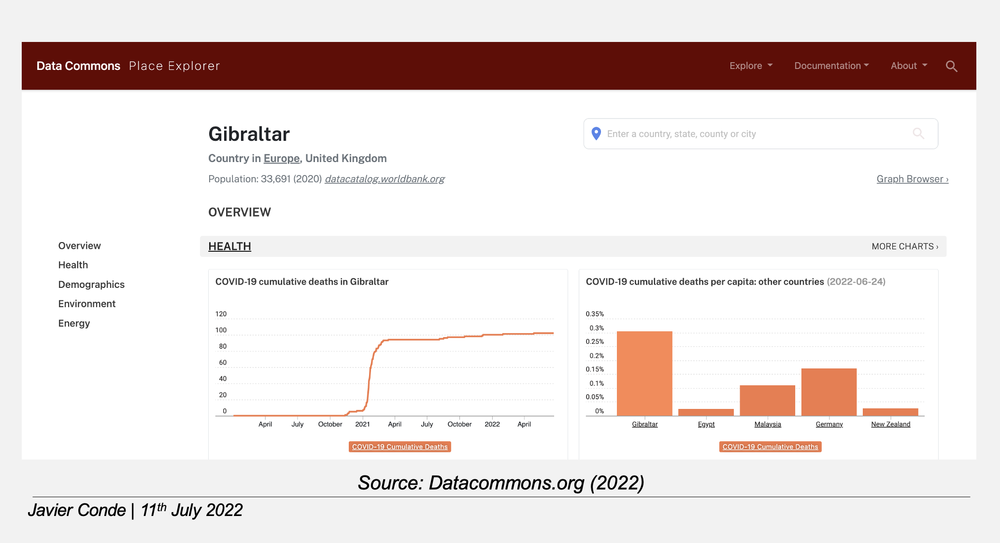

<AxesSubplot:xlabel='Date'>

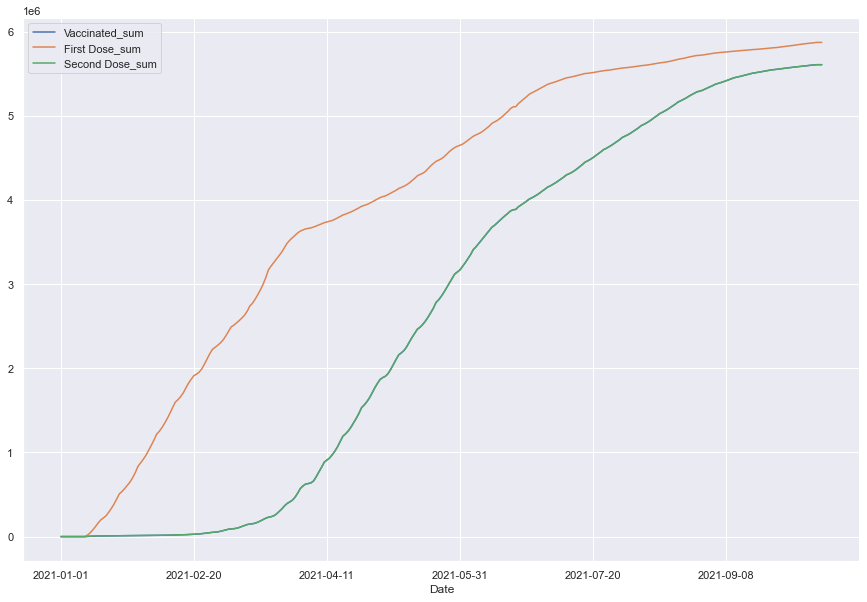

In [280]:
# Are there any visualisations that could be added here to make it easier?
# Simple visualisation with Pandas

vac_gibraltar_subset_2021.plot()


In [279]:
# More detailed visualisation with Matplotlib

import matplotlib.pyplot as plt

### 2.2) Presentation expectations:
Use the process of exploring the data for Gibraltar as an example to provide a brief description of the various phases to help your team to understand the process. Keep it high level and make sure to focus on both specifics relating to the case (first dose, second dose per region, total and over time) and brief observations regarding the process. Assignment activity 2 considers basic data exploration.
- Can we make decisions based on total numbers only, or do trends over time offer additional insights?
- Why it is important to explore the data, what are the typical mistakes made in this phase?

In [99]:
# Always important to keep an eye on data quality, understanding data shape & data types at all times and look for:
# 1. Missing values
# 2. Data types
# 3. Inconsistency in column names
# 4. Possible duplicate entries
# 5. Inconsistent data entry & spelling
# 6. Start looking for possible outliers with the .describe() method

## 3) Assignment activity 3: 

### 3.1) Report expectations:
- Merge and explore the data.
- Convert the data type of the Date column from object to DateTime.
- Create a data set that meets the expected parameters.
- Add calculated features to DataFrames (difference between first and second dose vaccinations).
- Filter and sort output.
- Observe totals and percentages as a total and over time.
- Note observations.

Merge the DataFrames without duplicating columns. The new DataFrame (e.g. `covid`) will have `7584` rows and the following columns: `Province/State, Country/Region, Date, Vaccinated, First Dose, Second Dose, Deaths, Cases, Recovered, Hospitalised`.

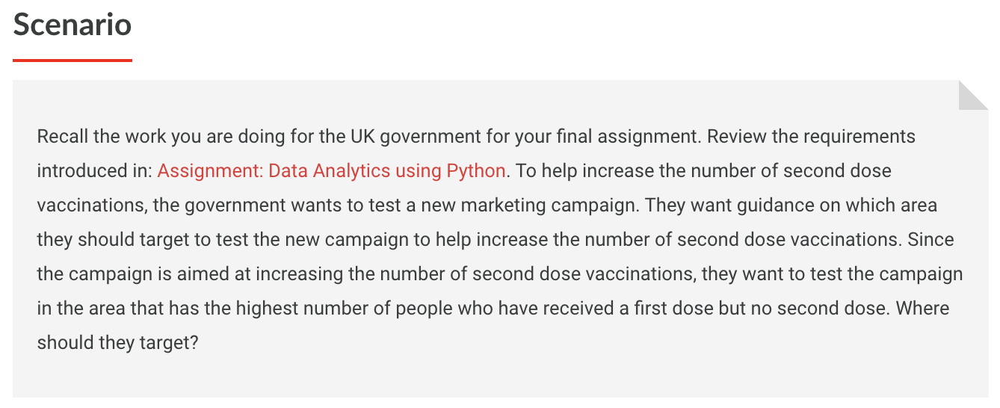

In [258]:
# Join the DataFrames as covid where you merge cov and vac

covid = pd.merge(vac, cov, how = 'inner')

In [259]:
# Let's explore the 'covid' DataFrame with 'shape', 'dtypes','columns', 'head', 'tail' arguments.

print(covid.shape)
print(covid.dtypes)
print(covid.columns)
covid.head()

(7584, 18)
Province/State               object
Country/Region               object
Lat                         float64
Long                        float64
ISO 3166-1 Alpha 3-Codes     object
Sub-region Name              object
Intermediate Region Code      int64
Date                         object
Vaccinated                    int64
First Dose                    int64
Second Dose                   int64
Vaccinated_sum                int64
First Dose_sum                int64
Second Dose_sum               int64
Deaths                      float64
Cases                       float64
Recovered                   float64
Hospitalised                float64
dtype: object
Index(['Province/State', 'Country/Region', 'Lat', 'Long',
       'ISO 3166-1 Alpha 3-Codes', 'Sub-region Name',
       'Intermediate Region Code', 'Date', 'Vaccinated', 'First Dose',
       'Second Dose', 'Vaccinated_sum', 'First Dose_sum', 'Second Dose_sum',
       'Deaths', 'Cases', 'Recovered', 'Hospitalised'],
      dtype

,Province/State,Country/Region,Lat,Long,ISO 3166-1 Alpha 3-Codes,Sub-region Name,Intermediate Region Code,Date,Vaccinated,First Dose,Second Dose,Vaccinated_sum,First Dose_sum,Second Dose_sum,Deaths,Cases,Recovered,Hospitalised
0,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-22,0,0,0,0,0,0,0.0,0.0,0.0,0.0
1,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-23,0,0,0,0,0,0,0.0,0.0,0.0,0.0
2,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-24,0,0,0,0,0,0,0.0,0.0,0.0,0.0
3,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-25,0,0,0,0,0,0,0.0,0.0,0.0,0.0
4,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-26,0,0,0,0,0,0,0.0,0.0,0.0,0.0


In [261]:
# Now fix the date column data type.

covid['Date'] = covid['Date'].astype('datetime64')
print(covid.dtypes)

Province/State                      object
Country/Region                      object
Lat                                float64
Long                               float64
ISO 3166-1 Alpha 3-Codes            object
Sub-region Name                     object
Intermediate Region Code             int64
Date                        datetime64[ns]
Vaccinated                           int64
First Dose                           int64
Second Dose                          int64
Vaccinated_sum                       int64
First Dose_sum                       int64
Second Dose_sum                      int64
Deaths                             float64
Cases                              float64
Recovered                          float64
Hospitalised                       float64
dtype: object


In [344]:
# After merging both DataFrames, let's drop unnecessary columns.

covid_lean = covid[['Province/State', 'Date', 'Vaccinated', 'First Dose',
                    'Second Dose', 'Deaths', 'Cases', 'Recovered', 'Hospitalised']]
covid_lean

,Province/State,Date,Vaccinated,First Dose,Second Dose,Deaths,Cases,Recovered,Hospitalised
0,Anguilla,2020-01-22,0,0,0,0.0,0.0,0.0,0.0
1,Anguilla,2020-01-23,0,0,0,0.0,0.0,0.0,0.0
2,Anguilla,2020-01-24,0,0,0,0.0,0.0,0.0,0.0
3,Anguilla,2020-01-25,0,0,0,0.0,0.0,0.0,0.0
4,Anguilla,2020-01-26,0,0,0,0.0,0.0,0.0,0.0
5,Anguilla,2020-01-27,0,0,0,0.0,0.0,0.0,0.0
6,Anguilla,2020-01-28,0,0,0,0.0,0.0,0.0,0.0
7,Anguilla,2020-01-29,0,0,0,0.0,0.0,0.0,0.0
8,Anguilla,2020-01-30,0,0,0,0.0,0.0,0.0,0.0
9,Anguilla,2020-01-31,0,0,0,0.0,0.0,0.0,0.0


In [345]:
# We use 'groupby' and calculate total difference between first and second dose, by 'Province/State'

covid_lean['Missing Second Dose'] = covid_lean['First Dose'] - covid_lean['Second Dose']


/var/folders/_k/8h4zfdrd3qgd4kzz6qhbbzyh0000gn/T/ipykernel_57999/1006210800.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  covid_lean['Missing Second Dose'] = covid_lean['First Dose'] - covid_lean['Second Dose']


In [346]:
covid_lean

,Province/State,Date,Vaccinated,First Dose,Second Dose,Deaths,Cases,Recovered,Hospitalised,Missing Second Dose
0,Anguilla,2020-01-22,0,0,0,0.0,0.0,0.0,0.0,0
1,Anguilla,2020-01-23,0,0,0,0.0,0.0,0.0,0.0,0
2,Anguilla,2020-01-24,0,0,0,0.0,0.0,0.0,0.0,0
3,Anguilla,2020-01-25,0,0,0,0.0,0.0,0.0,0.0,0
4,Anguilla,2020-01-26,0,0,0,0.0,0.0,0.0,0.0,0
5,Anguilla,2020-01-27,0,0,0,0.0,0.0,0.0,0.0,0
6,Anguilla,2020-01-28,0,0,0,0.0,0.0,0.0,0.0,0
7,Anguilla,2020-01-29,0,0,0,0.0,0.0,0.0,0.0,0
8,Anguilla,2020-01-30,0,0,0,0.0,0.0,0.0,0.0,0
9,Anguilla,2020-01-31,0,0,0,0.0,0.0,0.0,0.0,0


In [365]:
covid_lean_province_sum = covid_lean.groupby('Province/State')[['First Dose', 'Second Dose',\
                                                                'Missing Second Dose',]]\
.sum().sort_values('Missing Second Dose', ascending=False)

covid_lean_province_sum

,First Dose,Second Dose,Missing Second Dose
Province/State,,,
Gibraltar,5870786,5606041,264745
Montserrat,5401128,5157560,243568
British Virgin Islands,5166303,4933315,232988
Anguilla,4931470,4709072,222398
Isle of Man,4226984,4036345,190639
Falkland Islands (Malvinas),3757307,3587869,169438
Cayman Islands,3522476,3363624,158852
Channel Islands,3287646,3139385,148261
Turks and Caicos Islands,3052822,2915136,137686


In [269]:
# Let's add now the column'% Missing Second Dose' with these same numbers in percentages

In [348]:
covid_lean_province_sum['% Missing Second Dose'] = (covid_lean_province_sum['Missing Second Dose']\
                                                /covid_lean_province_sum['First Dose'])* 100
covid_lean_province_sum

,First Dose,Second Dose,Missing Second Dose,% Missing Second Dose
Province/State,,,,
Gibraltar,5870786,5606041,264745,4.509532
Montserrat,5401128,5157560,243568,4.509577
British Virgin Islands,5166303,4933315,232988,4.509763
Anguilla,4931470,4709072,222398,4.509771
Isle of Man,4226984,4036345,190639,4.510048
Falkland Islands (Malvinas),3757307,3587869,169438,4.509560
Cayman Islands,3522476,3363624,158852,4.509669
Channel Islands,3287646,3139385,148261,4.509640
Turks and Caicos Islands,3052822,2915136,137686,4.510122


In [271]:
# This DataFrame answers both questions: "Which Province/State has the highest number/percentage of individuals 
# who have received a first dose but not a second dose?" Gibraltar, with 264,745 individuals (4.5%)
# missing their second doses.

In [329]:
# METHOD 1

In [366]:
# Let's split the date column into year-month-day to filter it better.

covid_lean['Month'] = covid_lean['Date'].dt.month
covid_lean['Year'] = covid_lean['Date'].dt.year

/var/folders/_k/8h4zfdrd3qgd4kzz6qhbbzyh0000gn/T/ipykernel_57999/1046729665.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  covid_lean['Month'] = covid_lean['Date'].dt.month
/var/folders/_k/8h4zfdrd3qgd4kzz6qhbbzyh0000gn/T/ipykernel_57999/1046729665.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  covid_lean['Year'] = covid_lean['Date'].dt.year


In [367]:
covid_lean

,Province/State,Date,Vaccinated,First Dose,Second Dose,Deaths,Cases,Recovered,Hospitalised,Missing Second Dose,Month,Year
0,Anguilla,2020-01-22,0,0,0,0.0,0.0,0.0,0.0,0,1,2020
1,Anguilla,2020-01-23,0,0,0,0.0,0.0,0.0,0.0,0,1,2020
2,Anguilla,2020-01-24,0,0,0,0.0,0.0,0.0,0.0,0,1,2020
3,Anguilla,2020-01-25,0,0,0,0.0,0.0,0.0,0.0,0,1,2020
4,Anguilla,2020-01-26,0,0,0,0.0,0.0,0.0,0.0,0,1,2020
5,Anguilla,2020-01-27,0,0,0,0.0,0.0,0.0,0.0,0,1,2020
6,Anguilla,2020-01-28,0,0,0,0.0,0.0,0.0,0.0,0,1,2020
7,Anguilla,2020-01-29,0,0,0,0.0,0.0,0.0,0.0,0,1,2020
8,Anguilla,2020-01-30,0,0,0,0.0,0.0,0.0,0.0,0,1,2020
9,Anguilla,2020-01-31,0,0,0,0.0,0.0,0.0,0.0,0,1,2020


In [380]:
covid_lean_2021=covid_lean.query('Date >=20210101')
covid_lean_2021

,Province/State,Date,Vaccinated,First Dose,Second Dose,Deaths,Cases,Recovered,Hospitalised,Missing Second Dose,Month,Year
345,Anguilla,2021-01-01,0,0,0,0.0,13.0,12.0,2771.0,0,1,2021
346,Anguilla,2021-01-02,0,0,0,0.0,13.0,12.0,2894.0,0,1,2021
347,Anguilla,2021-01-03,0,0,0,0.0,15.0,13.0,3048.0,0,1,2021
348,Anguilla,2021-01-04,0,0,0,0.0,15.0,13.0,3231.0,0,1,2021
349,Anguilla,2021-01-05,0,0,0,0.0,15.0,13.0,3222.0,0,1,2021
350,Anguilla,2021-01-06,0,0,0,0.0,15.0,13.0,3354.0,0,1,2021
351,Anguilla,2021-01-07,0,0,0,0.0,15.0,13.0,3421.0,0,1,2021
352,Anguilla,2021-01-08,0,0,0,0.0,15.0,13.0,3547.0,0,1,2021
353,Anguilla,2021-01-09,0,0,0,0.0,15.0,13.0,3573.0,0,1,2021
354,Anguilla,2021-01-10,0,0,0,0.0,15.0,13.0,3716.0,0,1,2021


In [374]:
import matplotlib.pyplot as plt

<AxesSubplot:xlabel='Date', ylabel='Vaccinated'>

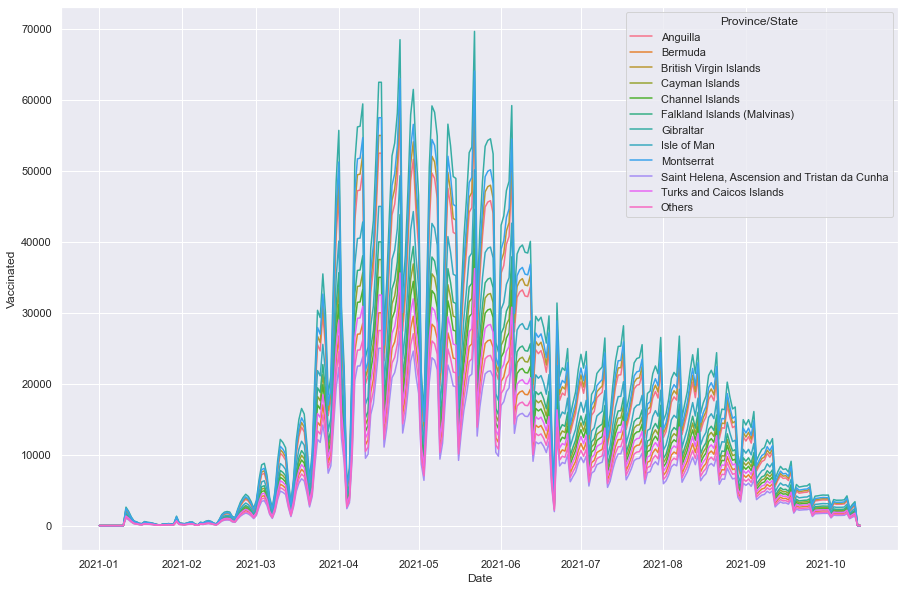

In [381]:
sns.lineplot(x='Date', y='Vaccinated', hue='Province/State', data=covid_lean_2021, ci=None)

In [383]:
# METHOD 2

# Groupby and calculate the difference between first and second dose over time.
# 1. Total global breakdown

covid_lean_total_sum = covid_lean.groupby(['Year', 'Month'])[['First Dose','Second Dose','Missing Second \
Dose']].sum().sort_values(['Year','Month'],ascending = [True, True])

covid_lean_total_sum['% Missing Second Dose'] = (covid_lean_total_sum['Missing Second Dose']\
                                                / covid_lean_total_sum['First Dose'])* 100
covid_lean_total_sum


First Dose  Second Dose  Missing Second Dose  \
Year Month                                                 
2020 1               0            0                    0   
     2               0            0                    0   
     3               0            0                    0   
     4               0            0                    0   
     5               0            0                    0   
     6               0            0                    0   
     7               0            0                    0   
     8               0            0                    0   
     9               0            0                    0   
     10              0            0                    0   
     11              0            0                    0   
     12              0            0                    0   
2021 1         7009791       102807              6906984   
     2        10979089       321611             10657478   
     3        10872004      3697646              7174358   
     4         3214759     10443858             -7229099   
     5         5114952     10777396             -5662444   
     6         5383815      7313473             -1929658   
     7         1955401      5273975             -3318574   
     8         1271518      4587807             -3316289   
     9          775585      1991847             -1216262   
     10         389450       337925                51525   

            % Missing Second Dose  
Year Month                         
2020 1                        NaN  
     2                        NaN  
     3                        NaN  
     4                        NaN  
     5                        NaN  
     6                        NaN  
     7                        NaN  
     8                        NaN  
     9                        NaN  
     10                       NaN  
     11                       NaN  
     12                       NaN  
2021 1                  98.533380  
     2                  97.070695  
     3                  65.989288  
     4                -224.872191  
     5                -110.703756  
     6                 -35.841833  
     7                -169.713220  
     8                -260.813374  
     9                -156.818659  
     10                 13.230196

In [384]:
# 2. By region breakdown
covid_lean_region_sum = covid_lean.groupby(['Year', 'Month', 'Province/\
State'])[['First Dose', 'Second Dose', 'Missing Second Dose',]].sum().sort_values(['Year', 'Month'],
                                                                                  ascending = [True, True])
covid_lean_region_sum['% Missing Second Dose'] = (covid_lean_region_sum['Missing Second Dose']\
                                                / covid_lean_region_sum['First Dose'])* 100
covid_lean_region_sum

First Dose  \
Year Month Province/State                                             
2020 1     Anguilla                                               0   
           Bermuda                                                0   
           British Virgin Islands                                 0   
           Cayman Islands                                         0   
           Channel Islands                                        0   
           Falkland Islands (Malvinas)                            0   
           Gibraltar                                              0   
           Isle of Man                                            0   
           Montserrat                                             0   
           Others                                                 0   
           Saint Helena, Ascension and Tristan da Cunha           0   
           Turks and Caicos Islands                               0   
     2     Anguilla                                               0   
           Bermuda                                                0   
           British Virgin Islands                                 0   
           Cayman Islands                                         0   
           Channel Islands                                        0   
           Falkland Islands (Malvinas)                            0   
           Gibraltar                                              0   
           Isle of Man                                            0   
           Montserrat                                             0   
           Others                                                 0   
           Saint Helena, Ascension and Tristan da Cunha           0   
           Turks and Caicos Islands                               0   
     3     Anguilla                                               0   
           Bermuda                                                0   
           British Virgin Islands                                 0   
           Cayman Islands                                         0   
           Channel Islands                                        0   
           Falkland Islands (Malvinas)                            0   
           Gibraltar                                              0   
           Isle of Man                                            0   
           Montserrat                                             0   
           Others                                                 0   
           Saint Helena, Ascension and Tristan da Cunha           0   
           Turks and Caicos Islands                               0   
     4     Anguilla                                               0   
           Bermuda                                                0   
           British Virgin Islands                                 0   
           Cayman Islands                                         0   
           Channel Islands                                        0   
           Falkland Islands (Malvinas)                            0   
           Gibraltar                                              0   
           Isle of Man                                            0   
           Montserrat                                             0   
           Others                                                 0   
           Saint Helena, Ascension and Tristan da Cunha           0   
           Turks and Caicos Islands                               0   
     5     Anguilla                                               0   
           Bermuda                                                0   
           British Virgin Islands                                 0   
           Cayman Islands                                         0   
           Channel Islands                                        0   
           Falkland Islands (Malvinas)                            0   
           Gibraltar                                              0   
          

In [386]:
# To locate max and min moments of vaccination:

covid_lean_region_sum.loc[covid_lean_region_sum['First Dose'] == covid_lean_region_sum['First Dose'].max()]

,,,First Dose,Second Dose,Missing Second Dose,% Missing Second Dose
Year,Month,Province/State,,,,
2021,2,Gibraltar,1372385,40201,1332184,97.07072


In [387]:
covid_lean_region_sum.loc[covid_lean_region_sum['Second Dose'] == covid_lean_region_sum['Second Dose'].max()]

,,,First Dose,Second Dose,Missing Second Dose,% Missing Second Dose
Year,Month,Province/State,,,,
2021,5,Gibraltar,639366,1347172,-707806,-110.704354


In [388]:
covid_lean_region_sum.loc[covid_lean_region_sum['Missing Second Dose'] \
                          == covid_lean_region_sum['Missing Second Dose'].min()]

,,,First Dose,Second Dose,Missing Second Dose,% Missing Second Dose
Year,Month,Province/State,,,,
2021,4,Gibraltar,401847,1305483,-903636,-224.87066


In [ ]:
# Findings - evolution over time
# 1. Jan 2021 first records on vaccination
# 2. Gibraltar (876,224), Monserrat (806,126) and British Virgin Islands (771,077) provinces
# with best start on vaccination campaign
# 3. Gibraltar quickest to reach max 1st vacc dose (Feb 2021) and 2nd vacc dose (May 2021)
# Check other findings

### 3.2) Presentation expectations:
We use similar calculations and representations as we had in assignment activity 2, but now expand to look at all provinces. Assignment activity 3 is concerned with exploring data in the context of a specific business question (as opposed to general exploration in assignment activity 2).
- What insights can be gained from the data? (Description of all regions, assumptions and concerns, trends or patterns you have observed.)
- Are there limitations or assumptions that needs to be considered?
- Make sure to provide a brief overview of the data and typical considerations at this phase of analysis.

## 4) Assignment activity 4: 

The government is looking to promote second dose vaccinations and would like to know the best possible area to test a new campaign. They are looking for the highest number of people who have received a first dose and not a second dose. 
- Where should they target?
- Which provinces have the highest number (actual numbers) and highest relative numbers (second dose only/first dose)?
- Visualise both outputs.

### 4.1) Report expectations:
- Consider additional features (deaths and recoveries).
- Visualise the data.
- Note observations:
 - Do deaths follow the same patterns observed in vaccination data (daily vs cumulative)?
 - Do we need to separate groups of data for specific variables and analyse them in isolation (Others) to be able to observe the patterns?

### 4.2) Presentation expectations:
- What insights can be gained from the data?
- Why do we need to consider other features?
- **Hints**: 
 - Evalute different features to improve decision making (deaths and recoveries). 
 - Why it is important to explore data and use different views?
 - Highlight two or three suggestions to get junior team members started in terms of good practices.

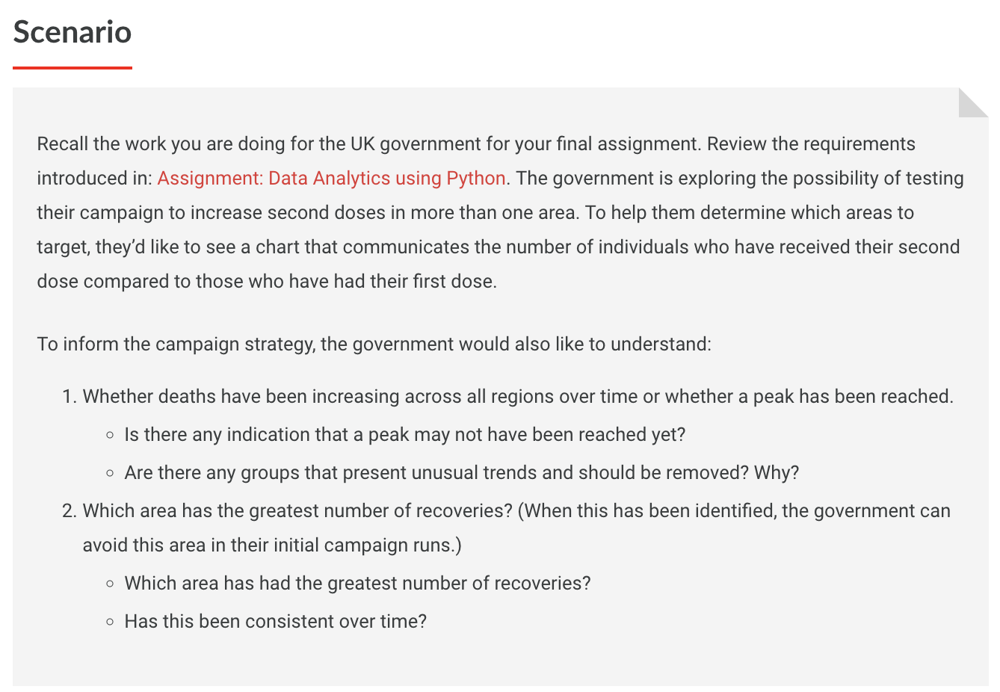

In [217]:
# Data is grouped already from the previous activity.
# The ratio of people who have received the second dose over the first dose can be easily looked up in 
# the new column that holds the % 'Missing Second Dose' value (e.g. First Percentage).

covid_date_province_sum

,First Dose,Second Dose,Missing Second Dose,% Missing Second Dose
Province/State,,,,
Gibraltar,5870786,5606041,264745,4.509532
Montserrat,5401128,5157560,243568,4.509577
British Virgin Islands,5166303,4933315,232988,4.509763
Anguilla,4931470,4709072,222398,4.509771
Isle of Man,4226984,4036345,190639,4.510048
Falkland Islands (Malvinas),3757307,3587869,169438,4.509560
Cayman Islands,3522476,3363624,158852,4.509669
Channel Islands,3287646,3139385,148261,4.509640
Turks and Caicos Islands,3052822,2915136,137686,4.510122


In [226]:
# Let's create a vertical grouped bar plot per region on fully vaccinated vs only 1st dose in seaborn.
# Seaborn can not interpret index so let's make 'Province/State' a column.

covid_date_province_sum['Province/State'] = covid_date_province_sum.index
covid_date_province_sum


,First Dose,Second Dose,Missing Second Dose,% Missing Second Dose,Province/State
Province/State,,,,,
Gibraltar,5870786,5606041,264745,4.509532,Gibraltar
Montserrat,5401128,5157560,243568,4.509577,Montserrat
British Virgin Islands,5166303,4933315,232988,4.509763,British Virgin Islands
Anguilla,4931470,4709072,222398,4.509771,Anguilla
Isle of Man,4226984,4036345,190639,4.510048,Isle of Man
Falkland Islands (Malvinas),3757307,3587869,169438,4.509560,Falkland Islands (Malvinas)
Cayman Islands,3522476,3363624,158852,4.509669,Cayman Islands
Channel Islands,3287646,3139385,148261,4.509640,Channel Islands
Turks and Caicos Islands,3052822,2915136,137686,4.510122,Turks and Caicos Islands


<AxesSubplot:xlabel='Province/State', ylabel='First Dose'>

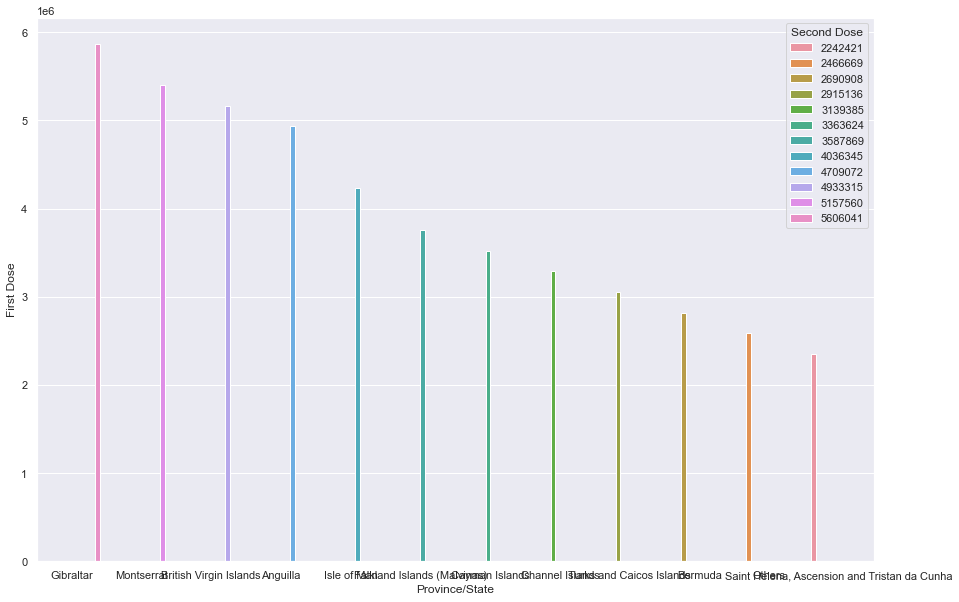

In [231]:
sns.barplot(x='Province/State', y='First Dose', hue = 'Second Dose', data=covid_date_province_sum)

In [ ]:
# Relative numbers (%)

In [ ]:
# Sort and display

In [ ]:
# Visualise

In [ ]:
# Smooth out the data by looking at monthly figures

In [ ]:
# Other features evaluated (data preparation, output and plots)

***Notes and observations:***
Your observations here. (Double click to edit)

***Examples could include:***
- Are there other trends in terms of recoveries or hospitalisations compared to other features that you found interesting and that may add value in terms of the decision making process?
- Any other observations regarding the data?
- Any suggestions for improvements and further analysis?
- What would your future data requirements be?

## 5) Assignment activity 5: External data 
In the next section, you were supplied with a sample file and the question was asked to determine whether there are additional `#tags` or keywords that could potentially provide insights into your COVID-19 analysis. While the sample set is limited, you were asked to review the provided file and demonstrate the typical steps and make recommendations regarding future use of similar data sets to provide richer insights.

### 5.1) Report expectations:
- Demonstrate basic ability to work with Twitter data.
- Search for hash-tags or keywords.
- Create DataFrames and visualisations.
- Note your observations.

In [ ]:
# Import the tweet data set


In [ ]:
# Explore the data: info(), head()


In [ ]:
# Explore the structure, count the tweets, get the elements of interest


In [ ]:
# Create a DataFrame with the text only


In [ ]:
# Loop through the messages and build a list of values containing the #-symbol


In [ ]:
# Filter and sort


In [ ]:
# Plot


### 5.2) Presentation expectations:
Discuss whether external data could potentially be used and whether it is a viable solution to pursue. Discuss your assumptions and suggestions. 

Points to consider:
- What insights can be gained from the data?
- What are the advantages and disadvantages of using external data?
- How would you suggest using external data in the project?

## 6) Assignment activity 6: 

### 6.1) Report expectations:
- Demonstrate using external function and interpret results.
- Note observations.

In [ ]:
# You can copy and paste the relevant code cells from the provided template here.

### 6.2) Presentation expectations:
- **Question 1**: We have heard of both qualitative and quantitative data from the previous consultant. What are the differences between the two? Should we use only one or both of these types of data and why? How can these be used in business predictions? Could you provide examples of each?
- **Question 2**: We have also heard a bit about the need for continuous improvement. Why should this be implemented, it seems like a waste of time. Why can’t we just implement the current project as it stands and move on to other pressing matters?
- **Question 3**: As a government, we adhere to all data protection requirements and have good governance in place. We only work with aggregated data and therefore will not expose any personal details. Have we covered everything from a data ethics standpoint? Is there anything else we need to implement from a data ethics perspective? 